# Plotly Exercises

This notebook contains several Plotly exercises to get used with that library.

## Table of contents

* Exercise 1.1: Subplots
* Exercise 1.2: Scatter plots
* Exercise 1.3: Maps with GeoJSON
* Exercise 1.4: Advanced Customization

## Import dependencies

In [51]:
import plotly.graph_objects as go
import plotly.express as px
import plotly.io as pio
#pio.renderers.default = 'colab'   # try changing this in case your plots aren't shown
import pandas as pd
import dash
import dash_core_components as dcc
from dash import html
from dash.dependencies import Input, Output, State

from jupyter_dash import JupyterDash

## Exercise 1.1: Subplots

* Create a subplot with two rows, and two columns in the first row, but just one column in the second (bottom) row.
* In the top left, plot a boxplot comparing tips distribution for category smoker.
* In the top right, plot a scatter plot with the total bill in the x-axis and the tip in the y-axis.
* In the bottom, plot a bar chart with the total bills (y-axis) per day (x-axis). Use a trace per `sex`.

### Help

* [Subplots](https://plotly.com/python/subplots/)
* [Box plots](https://plotly.com/python/box-plots/)
* [Scatter plots](https://plotly.com/python/line-and-scatter/)
* [Bar charts](https://plotly.com/python/bar-charts/)

### Dataset

The dataset is presented bellow. It is a dataframe with records for bills and tips in a restaurant for several days and types of clients.

In [52]:
ds_e1 = px.data.tips()
ds_e1.head()

,total_bill,tip,sex,smoker,day,time,size
0,16.99,1.01,Female,No,Sun,Dinner,2
1,10.34,1.66,Male,No,Sun,Dinner,3
2,21.01,3.50,Male,No,Sun,Dinner,3
3,23.68,3.31,Male,No,Sun,Dinner,2
4,24.59,3.61,Female,No,Sun,Dinner,4


### Your code

In [53]:
# Start your code here

## Exercise 1.2: Scatter plots

Let's plot a scatter plot with the iris dataset as follows:

* Sepal length in the `x`axis and sepal width in the `y`axis. 
* The area of the bubbles must be proportional to the petal's length.
* Add a trace per species.
* Marker's shape should be `square`.
* Modify the hover template so all information is displayed together.
* Change color background for the chart and the whole plot.
* Add title, and `x` and `y` labels with font size 18.

### Help

* [Scatter plots](https://plotly.com/python/line-and-scatter/)
* [Hover](https://plotly.com/python/hover-text-and-formatting/)
* [Axis](https://plotly.com/python/figure-labels/)

### Dataset

The dataset presented bellow consists of records of different species of flowers with records for different characteristics.

In [54]:
ds_e2 = px.data.iris()
ds_e2.head()

,sepal_length,sepal_width,petal_length,petal_width,species,species_id
0,5.1,3.5,1.4,0.2,setosa,1
1,4.9,3.0,1.4,0.2,setosa,1
2,4.7,3.2,1.3,0.2,setosa,1
3,4.6,3.1,1.5,0.2,setosa,1
4,5.0,3.6,1.4,0.2,setosa,1


### Your code

In [55]:
# Start your code here

## Exercise 1.3: Maps

In this last exercise we will use Plotly Express and a GeoJSON object to plot polygons on a Map. We will come back to the elections dataset used before.

* Use Choropleth mapbox to plot the polygons in the GeoJson object.
* Color each district or polygon according to the winner.

### Help

* [Maps](https://plotly.com/python/maps/)
* [Plotly Express](https://plotly.com/python/plotly-express/)

### Dataset

The dataset consists of a GeoJSON object, containing the polygons defining the shape of each district. There is also a dataset contaning the elections results for each district.

In [56]:
geojson2 = px.data.election_geojson()
ds = px.data.election()

In [57]:
ds.head()

,district,Coderre,Bergeron,Joly,total,winner,result,district_id
0,101-Bois-de-Liesse,2481,1829,3024,7334,Joly,plurality,101
1,102-Cap-Saint-Jacques,2525,1163,2675,6363,Joly,plurality,102
2,11-Sault-au-Récollet,3348,2770,2532,8650,Coderre,plurality,11
3,111-Mile-End,1734,4782,2514,9030,Bergeron,majority,111
4,112-DeLorimier,1770,5933,3044,10747,Bergeron,majority,112


In [58]:
#geojson

### Sample plot using Choropleth mapbox

Below figure is plotted using Plotly GO but the same is also possible with Plotly Express. You can check it out [here](https://plotly.com/python/mapbox-county-choropleth/).

In [59]:
from urllib.request import urlopen
import json
with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
    counties = json.load(response)

import pandas as pd
df = pd.read_csv("https://raw.githubusercontent.com/plotly/datasets/master/fips-unemp-16.csv",
                   dtype={"fips": str})

# Sample Choropleth mapbox using Plotly GO
import plotly.graph_objects as go

fig = go.Figure(go.Choroplethmapbox(geojson=counties, locations=df.fips, z=df.unemp,
                                    colorscale="Viridis", zmin=0, zmax=12,
                                    marker_opacity=0.5, marker_line_width=0))
fig.update_layout(mapbox_style="carto-positron",
                  mapbox_zoom=3, mapbox_center = {"lat": 37.0902, "lon": -95.7129})
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

### Your code

In [60]:
# Start your code here
import seaborn as sns

def winnerf(row):
    if row.winner=='Coderre':
        return 0
    if row.winner=='Bergeron':
        return 1
    if row.winner=='Joly':
        return 2
ds['winner_code']=ds.apply(lambda row: winnerf(row), axis=1)
ds['winner_code'].unique()

array([2, 0, 1], dtype=int64)

In [61]:
gyr = ['#e41a1c','#377eb8','#4daf4a']

fig2 = go.Figure(go.Choroplethmapbox(geojson=geojson2, locations=ds['district_id'], z=ds.winner_code,
                                    colorscale=gyr, hovertext=ds.winner,
                                    marker_opacity=0.5, marker_line_width=0, showlegend=False))

fig2.update_layout(mapbox_style="carto-positron", mapbox_zoom=9,mapbox_center = {"lat": 45.5019, "lon": -73.5674})
fig2.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig2.show()

In [62]:
import plotly.express as px

fig4 = px.choropleth_mapbox(ds, geojson=geojson2, color="winner",
                           locations="district", featureidkey="properties.district",
                           center={"lat": 45.5517, "lon": -73.7073},
                           mapbox_style="carto-positron", zoom=9)
fig4.update_layout(margin={"r":0,"t":0,"l":0,"b":0},
                   )
fig4.show()

## Exercise 1.4: Advanced customization

In this final exercise you can start working on the plots for the visualization mini project. Tomorrow you will complete this project, and (optionally) push your code to GitHub and deploy it as a small web app online to showcase your work to others. 

To get started, have a look at the three datasets presented on the [Mini Project page](https://monolith.propulsion-home.ch/backend/api/momentum/materials/ds-materials/02_Visualization/day3/pages/mini_project_1.html) on Momentum and select the one that you're most interested in.


### Choropleth Map

- use ``px.choropleth_mapbox()`` to create a choropleth map showing the geographic features from the geoJSON file or just use ``px.choropleth()`` for a world map (geoJSON file not required).
- if necessary, adjust display options of your map, such as the center latitude and longitude, the zoom, size and margins
- once you're satisfied with the geographic features, add data to the map, showing some relevant information from your dataset
- adjust the hover tooltips to display meaningful information
- add a title and adjust the legend, if required
- choose a mapbox style and color scale to your taste
- customize your map further as you like

**Note:** You'll get access to a wider range of customization options, if you [create a Mapbox Account](https://account.mapbox.com/auth/signup/) and use your mapbox access token in your plots. A credit card is required, but you will get up to 50'000 free map loads.


### Other Plot Types

- explore your dataset further and try out some more simple plot types (scatter, line, bar plots) to show different aspects of your data
- adjust the hover tooltips to display meaningful information
- add a title and adjust the legend, if required
- align the style with your choropleth map


### Bonus: 

If you're having fun and want to spend some more time on this: 

-  use categorical features from your dataset to create a [Sankey Diagram](https://plotly.com/python/sankey-diagram/) or a [Treemap](https://plotly.com/python/treemaps/)


### Help

* [Legend](https://plotly.com/python/legend/)
* [Axis](https://plotly.com/python/axes/)
* [Annotations](https://plotly.com/python/text-and-annotations/)
* [Ticks format](https://plotly.com/python/tick-formatting/)
* [D3 Format](https://github.com/d3/d3-format/blob/master/README.md#locale_format)


### Your code

In [22]:
# Start your code here

df=pd.read_csv("../data/raw/renewable_power_plants_CH.csv")
geojson4 = json.load(open("../data/raw/georef-switzerland-kanton.geojson"))
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12718 entries, 0 to 12717
Data columns (total 22 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   electrical_capacity    12718 non-null  float64
 1   energy_source_level_1  12718 non-null  object 
 2   energy_source_level_2  12718 non-null  object 
 3   energy_source_level_3  277 non-null    object 
 4   technology             12587 non-null  object 
 5   data_source            12718 non-null  object 
 6   nuts_1_region          12708 non-null  object 
 7   nuts_2_region          12708 non-null  object 
 8   nuts_3_region          12708 non-null  object 
 9   lon                    12694 non-null  float64
 10  lat                    12694 non-null  float64
 11  municipality           12718 non-null  object 
 12  municipality_code      12718 non-null  int64  
 13  postcode               12694 non-null  float64
 14  address                3929 non-null   object 
 15  ca

In [23]:
df

,electrical_capacity,energy_source_level_1,energy_source_level_2,energy_source_level_3,technology,data_source,nuts_1_region,nuts_2_region,nuts_3_region,lon,...,municipality_code,postcode,address,canton,commissioning_date,contract_period_end,company,tariff,project_name,production
0,0.755,Renewable energy,Bioenergy,Biomass and biogas,Other or unspecified technology,BFE,CH0,CH05,CH057,9.0353,...,8514,8514.0,Holzhof / Hüttlingerstrasse 22,TG,2004-07-01,2024-12-31,Otto Wartmann,578451.74,BHKW Wartmann Holzhof Bissegg,1127.504840
1,0.080,Renewable energy,Bioenergy,Biomass and biogas,Other or unspecified technology,BFE,CH0,CH05,CH056,9.8393,...,7260,7260.0,Duchliweg 13,GR,2004-11-24,2024-12-31,Davos Biogas GmbH,228421.43,Biogasanlage Davos,499.121100
2,0.260,Renewable energy,Bioenergy,Biomass and biogas,Other or unspecified technology,BFE,CH0,CH06,CH061,8.2363,...,6294,6294.0,Grundacher 2,LU,2005-10-04,2025-12-31,Armin Müller-Flühler,622598.25,B BHKW Armin Müller-Flühler Ermensee,1475.022780
3,0.450,Renewable energy,Hydro,NaN,Other or unspecified technology,BFE,CH0,CH02,CH021,7.2549,...,2535,2535.0,Rue du canal 41,BE,2006-01-01,2031-12-31,Hydroelectra AG,349496.84,Wasserkraftanlage Frinvillier,1327.936800
4,0.480,Renewable energy,Bioenergy,Biomass and biogas,Other or unspecified technology,BFE,CH0,CH01,CH012,7.9084,...,3930,3930.0,Grosseye 12,VS,2006-01-01,2026-12-31,Val Biogas GmbH,598309.74,Biogas Val Visp,1425.604275
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12713,2.372,Renewable energy,Hydro,NaN,Run-of-river,BFE,CH0,CH01,CH012,6.8670,...,1896,1896.0,Route de Miex 24,VS,2018-11-07,2043-11-30,Energie Renouvelable Vouvry SA,52190.56,Energie Renouvelable Vouvry SA Renens - Centra...,382.949250
12714,0.075,Renewable energy,Hydro,NaN,Other or unspecified technology,BFE,CH0,CH01,CH012,7.3160,...,1997,1997.0,Réservoir de Siviez,VS,2018-11-21,2038-11-30,Service électrique intercommunal S.A. - SEIC,6884.42,Turbinage Pra Mounet - Siviez,29.259825
12715,0.165,Renewable energy,Bioenergy,Biomass and biogas,Other or unspecified technology,BFE,CH0,CH06,CH063,8.8318,...,6436,6436.0,Hauptstrasse 5,SZ,2018-12-03,2038-12-31,Möbelfabrik Muotathal Paul von Rickenbach AG,35702.98,B Möbelfabrik Muotathal - BHKW,104.613120
12716,0.045,Renewable energy,Hydro,NaN,Other or unspecified technology,BFE,CH0,CH02,CH022,7.0582,...,1669,1669.0,Route du Moulin 8,FR,2018-12-10,2043-12-31,Groupe E Greenwatt SA,3141.77,Petite centrale hydroélectrique Neirivue Moura,13.296500


In [24]:
fig5=  px.choropleth_mapbox(geojson=geojson4,mapbox_style="carto-positron",
                           featureidkey="properties.kan_code",
                           center={"lat": 46.8182, "lon": 8.2275},zoom=6.5)
fig5.update_layout(margin={"r":0,"t":25,"l":0,"b":0})
fig5.update_layout(title_text='Map of Schweiz')
fig5.show()

In [25]:
geojson4['features'][1]['properties']

{'kan_type': 'Kanton',
 'geo_point_2d': [47.7135545771, 8.59172786185],
 'kan_code': '14',
 'year': '2020',
 'kan_name': 'Schaffhausen',
 'kan_area_code': 'CHE'}

In [26]:
codes=[]
name=[]
for index in range (26):
    codes.append(geojson4['features'][index]['properties']['kan_code'])
    name.append(geojson4['features'][index]['properties']['kan_name'])

abbr=['GE','SH','UR','BE','FR','AG','GR','LU','BS','TI','OW','AR','SO','SZ','JU','SG','VS','TG','VD','BL','ZH','NW','GL','NE','ZG','AI']
df_kan=pd.DataFrame({'code':codes,'canton_name':name,'canton':abbr})
df_kan.reset_index()

,index,code,canton_name,canton
0,0,25,Genève,GE
1,1,14,Schaffhausen,SH
2,2,04,Uri,UR
3,3,02,Bern,BE
4,4,10,Fribourg,FR
5,5,19,Aargau,AG
6,6,18,Graubünden,GR
7,7,03,Luzern,LU
8,8,12,Basel-Stadt,BS
9,9,21,Ticino,TI


In [27]:
df.canton.unique()

array(['TG', 'GR', 'LU', 'BE', 'VS', 'BL', 'SO', 'VD', 'SH', 'ZH', 'AG',
       'UR', 'NE', 'TI', 'SG', 'GE', 'GL', 'JU', 'ZG', 'OW', 'FR', 'SZ',
       'AR', 'AI', 'NW', 'BS'], dtype=object)

In [28]:
df['canton'].unique()

array(['TG', 'GR', 'LU', 'BE', 'VS', 'BL', 'SO', 'VD', 'SH', 'ZH', 'AG',
       'UR', 'NE', 'TI', 'SG', 'GE', 'GL', 'JU', 'ZG', 'OW', 'FR', 'SZ',
       'AR', 'AI', 'NW', 'BS'], dtype=object)

In [29]:
res=pd.merge(df,df_kan, how='left', on='canton')
res

,electrical_capacity,energy_source_level_1,energy_source_level_2,energy_source_level_3,technology,data_source,nuts_1_region,nuts_2_region,nuts_3_region,lon,...,address,canton,commissioning_date,contract_period_end,company,tariff,project_name,production,code,canton_name
0,0.755,Renewable energy,Bioenergy,Biomass and biogas,Other or unspecified technology,BFE,CH0,CH05,CH057,9.0353,...,Holzhof / Hüttlingerstrasse 22,TG,2004-07-01,2024-12-31,Otto Wartmann,578451.74,BHKW Wartmann Holzhof Bissegg,1127.504840,20,Thurgau
1,0.080,Renewable energy,Bioenergy,Biomass and biogas,Other or unspecified technology,BFE,CH0,CH05,CH056,9.8393,...,Duchliweg 13,GR,2004-11-24,2024-12-31,Davos Biogas GmbH,228421.43,Biogasanlage Davos,499.121100,18,Graubünden
2,0.260,Renewable energy,Bioenergy,Biomass and biogas,Other or unspecified technology,BFE,CH0,CH06,CH061,8.2363,...,Grundacher 2,LU,2005-10-04,2025-12-31,Armin Müller-Flühler,622598.25,B BHKW Armin Müller-Flühler Ermensee,1475.022780,03,Luzern
3,0.450,Renewable energy,Hydro,NaN,Other or unspecified technology,BFE,CH0,CH02,CH021,7.2549,...,Rue du canal 41,BE,2006-01-01,2031-12-31,Hydroelectra AG,349496.84,Wasserkraftanlage Frinvillier,1327.936800,02,Bern
4,0.480,Renewable energy,Bioenergy,Biomass and biogas,Other or unspecified technology,BFE,CH0,CH01,CH012,7.9084,...,Grosseye 12,VS,2006-01-01,2026-12-31,Val Biogas GmbH,598309.74,Biogas Val Visp,1425.604275,23,Valais
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12713,2.372,Renewable energy,Hydro,NaN,Run-of-river,BFE,CH0,CH01,CH012,6.8670,...,Route de Miex 24,VS,2018-11-07,2043-11-30,Energie Renouvelable Vouvry SA,52190.56,Energie Renouvelable Vouvry SA Renens - Centra...,382.949250,23,Valais
12714,0.075,Renewable energy,Hydro,NaN,Other or unspecified technology,BFE,CH0,CH01,CH012,7.3160,...,Réservoir de Siviez,VS,2018-11-21,2038-11-30,Service électrique intercommunal S.A. - SEIC,6884.42,Turbinage Pra Mounet - Siviez,29.259825,23,Valais
12715,0.165,Renewable energy,Bioenergy,Biomass and biogas,Other or unspecified technology,BFE,CH0,CH06,CH063,8.8318,...,Hauptstrasse 5,SZ,2018-12-03,2038-12-31,Möbelfabrik Muotathal Paul von Rickenbach AG,35702.98,B Möbelfabrik Muotathal - BHKW,104.613120,05,Schwyz
12716,0.045,Renewable energy,Hydro,NaN,Other or unspecified technology,BFE,CH0,CH02,CH022,7.0582,...,Route du Moulin 8,FR,2018-12-10,2043-12-31,Groupe E Greenwatt SA,3141.77,Petite centrale hydroélectrique Neirivue Moura,13.296500,10,Fribourg


In [79]:
res['electrical_capacity']=res['electrical_capacity'].fillna(0)

In [85]:
res.sort_values(by='electrical_capacity', ascending=True)

,electrical_capacity,energy_source_level_1,energy_source_level_2,energy_source_level_3,technology,data_source,nuts_1_region,nuts_2_region,nuts_3_region,lon,...,address,canton,commissioning_date,contract_period_end,company,tariff,project_name,production,code,canton_name
1129,0.0004,Renewable energy,Hydro,NaN,Other or unspecified technology,BFE,CH0,CH01,CH012,7.0032,...,NaN,VS,2008-07-01,2033-12-31,Natural person,119.78,Natural person,0.372000,23,Valais
972,0.0007,Renewable energy,Solar,NaN,Photovoltaics,BFE,CH0,CH03,CH033,8.1598,...,NaN,AG,2008-05-16,2033-12-31,Natural person,661.51,Natural person,0.735000,19,Aargau
379,0.0008,Renewable energy,Solar,NaN,Photovoltaics,BFE,CH0,CH01,CH012,7.3841,...,NaN,VS,2007-09-01,2032-12-31,Natural person,675.00,Natural person,0.900000,23,Valais
788,0.0008,Renewable energy,Solar,NaN,Photovoltaics,BFE,CH0,CH06,CH061,8.1726,...,NaN,LU,2008-04-07,2033-12-31,Natural person,621.75,Natural person,0.829000,03,Luzern
4675,0.0009,Renewable energy,Solar,NaN,Photovoltaics,BFE,CH0,CH02,CH024,6.7491,...,NaN,NE,2010-10-30,2035-12-31,Natural person,334.31,Natural person,0.453000,24,Neuchâtel
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10366,14.0000,Renewable energy,Hydro,NaN,Run-of-river,BFE,CH0,CH05,CH056,9.8761,...,Doggilochstrasse,GR,2013-06-07,2038-12-31,Repower AG,2286553.67,K Repower AG Klosters - Erneuerung KW,23620.852615,18,Graubünden
12689,14.7260,Renewable energy,Hydro,NaN,Run-of-river,BFE,CH0,CH01,CH012,8.3550,...,St. Niklaus,VS,2018-01-02,2043-01-31,FMV SA,5216565.56,K Kraftwerk Rhone Oberwald,46663.236600,23,Valais
10501,19.1000,Renewable energy,Hydro,NaN,Run-of-river,BFE,CH0,CH01,CH012,6.9541,...,Route de lIle-au-Bois 4,VS,2013-08-09,2038-12-31,Compagnie industrielle de Monthey SA (CIMO),4121512.50,K Compagnie industrielle de Monthey SA Cimo Mo...,52759.527000,23,Valais
8578,21.0000,Renewable energy,Bioenergy,Other bioenergy and renewable waste,Combustion engine,BFE,CH0,CH01,CH012,6.9541,...,Z.I. Boeuferrant 2,VS,2012-01-01,2032-12-31,Satom SA,5154868.00,"Satom, Bois en UIOM Agrandissement",46394.503948,23,Valais


In [86]:
df_grouped=res.groupby(['canton','code','canton_name','energy_source_level_1']).agg({'electrical_capacity':'sum'})
df_grouped=df_grouped.reset_index()
df_grouped

,canton,code,canton_name,energy_source_level_1,electrical_capacity
0,AG,19,Aargau,Renewable energy,89.44691
1,AI,16,Appenzell Innerrhoden,Renewable energy,3.22623
2,AR,15,Appenzell Ausserrhoden,Renewable energy,3.78421
3,BE,02,Bern,Renewable energy,183.86179
4,BL,13,Basel-Landschaft,Renewable energy,19.36666
5,BS,12,Basel-Stadt,Renewable energy,5.31017
6,FR,10,Fribourg,Renewable energy,35.18090
7,GE,25,Genève,Renewable energy,14.77881
8,GL,08,Glarus,Renewable energy,25.69639
9,GR,18,Graubünden,Renewable energy,161.11143


In [124]:
#add data to the map, showing some relevant information from your dataset
fig5=  px.choropleth_mapbox(df_grouped,geojson=geojson4,mapbox_style="carto-positron", color='electrical_capacity',
                            locations="code",featureidkey="properties.kan_code",
                           center={"lat": 46.8182, "lon": 8.2275},zoom=6.8,
                            hover_name='canton_name',
                            hover_data={'electrical_capacity':':.1f','code':False},
                           color_continuous_scale='YlGn',
                           labels={'electrical_capacity':'elec capacity (KW)'},
                           opacity=0.5)

fig5.update_layout(margin={"r":0,"t":45,"l":0,"b":0})
fig5.update_layout(title_text='Renewable Energy Capacity by Canton (MW)')





fig5.show()

In [88]:
df_grouped2=res.groupby(['canton','code','canton_name','energy_source_level_1','energy_source_level_2']).agg({'electrical_capacity':'sum'})
df_grouped2=df_grouped2.reset_index()
df_grouped2

,canton,code,canton_name,energy_source_level_1,energy_source_level_2,electrical_capacity
0,AG,19,Aargau,Renewable energy,Bioenergy,6.07200
1,AG,19,Aargau,Renewable energy,Hydro,36.00920
2,AG,19,Aargau,Renewable energy,Solar,47.35571
3,AG,19,Aargau,Renewable energy,Wind,0.01000
4,AI,16,Appenzell Innerrhoden,Renewable energy,Bioenergy,0.06000
...,...,...,...,...,...,...
78,ZG,09,Zug,Renewable energy,Hydro,1.62600
79,ZG,09,Zug,Renewable energy,Solar,9.25119
80,ZH,01,Zürich,Renewable energy,Bioenergy,8.08800
81,ZH,01,Zürich,Renewable energy,Hydro,2.67040


In [89]:
df_grouped2['energy_source_level_2'].unique()

array(['Bioenergy', 'Hydro', 'Solar', 'Wind'], dtype=object)

In [96]:
df_grouped3=df_grouped2.pivot_table(index=['canton_name'], columns='energy_source_level_2', values='electrical_capacity')
df_grouped3=df_grouped3.fillna(0)

In [97]:

df_grouped3['total']=df_grouped3['Bioenergy']+df_grouped3['Hydro']+df_grouped3['Solar']+df_grouped3['Wind']
df_grouped3=df_grouped3.sort_values(by='total', ascending=False)
df_grouped3

energy_source_level_2,Bioenergy,Hydro,Solar,Wind,total
canton_name,,,,,
Bern,9.1533,60.22540,83.24909,31.234,183.86179
Valais,22.2230,112.80600,19.35222,14.360,168.74122
Graubünden,1.0445,128.55440,28.51253,3.000,161.11143
Aargau,6.0720,36.00920,47.35571,0.010,89.44691
Vaud,6.5640,10.57300,61.61574,0.000,78.75274
St. Gallen,5.1090,16.82020,51.71934,0.100,73.74854
Luzern,7.6240,1.14850,60.76712,3.312,72.85162
Zürich,8.0880,2.67040,49.06643,0.000,59.82483
Thurgau,2.7230,3.95580,43.08717,0.000,49.76597


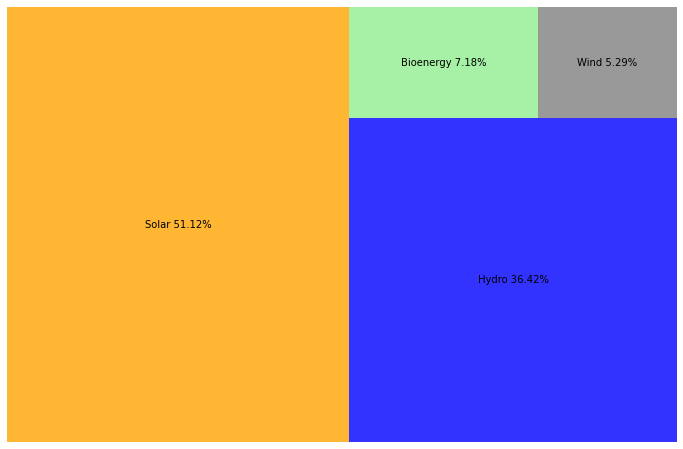

In [122]:
import squarify  
import matplotlib.pyplot as plt
df_grouped_sq=res.groupby('energy_source_level_2')['electrical_capacity'].sum().reset_index().sort_values(by='electrical_capacity',ascending=False)
df_grouped_sq['label']=df_grouped_sq.apply(lambda row: (row['energy_source_level_2']+ " "+ str('{:.2f}%'.format(row['electrical_capacity']/df_grouped_sq['electrical_capacity'].sum()*100))), axis=1)

fig, ax = plt.subplots(figsize=(12, 8))
ax=squarify.plot(sizes=df_grouped_sq['electrical_capacity'], label=df_grouped_sq['label'], alpha=.8 , color=['orange','blue','lightgreen','grey'])
ax.axis('off');


In [118]:
type(tree)

matplotlib.axes._subplots.AxesSubplot

In [98]:
# TO DO: Add the go.Bar traces
fig7 = go.Figure(data=[
    go.Bar(x=df_grouped3.index, y=df_grouped3['Bioenergy'],name='bioenergie',marker_color='lightgreen'),
    go.Bar(x=df_grouped3.index, y=df_grouped3['Hydro'],name='hydro',marker_color='blue'),
    go.Bar(x=df_grouped3.index, y=df_grouped3['Solar'],name='solar',marker_color='orange'),
    go.Bar(x=df_grouped3.index, y=df_grouped3['Wind'],name='wind',marker_color='grey')])   


# Update the layout

fig7.update_layout(
    barmode="stack",
    plot_bgcolor="white",
    
    hovermode="x unified",
    title={'text': "Renewable energy by type", "font": {"size": 24}}
)



fig7.show()